In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from tqdm import tqdm
from torch.utils.data import DataLoader, TensorDataset
from torch.cuda.amp import autocast, GradScaler
import random
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import plotly.graph_objs as go
import librosa
import IPython.display as ipd
from IPython.display import Audio
import os
from sklearn.decomposition import PCA
import umap
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
from transformers import SpeechT5HifiGan
from scipy.spatial.distance import cosine
from training_utils.models import VAE
from training_utils.loss_functions import disentangle_loss_function, KLD_function, compute_KL_weight
from scripts.generate_stft_specs import high_pass_filter, low_pass_filter, TacotronSTFT, get_hifi_mel
from data_utils.data import check_dataset, reconstruction_vis, latent_space_3D_vis, latent_space_2D_vis, calculate_timbre_effect_masks, copy_effects_vis

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [3]:
vocoder = SpeechT5HifiGan.from_pretrained("cvssp/audioldm-s-full-v2", subfolder='vocoder')

### Data Preparation

In [4]:
batch_size = 64

train_data = np.load('datasets/effects/nsynth-valid-hifi_guitar_with_params.npy')
valid_data = np.load('datasets/effects/nsynth-test-hifi_guitar_with_params.npy')
num_valid_samples = len(valid_data)
num_train_samples, _ , time_bins_num, freq_bins_num = train_data.shape
print(f"Number of training samples: {num_train_samples}", 
      f"Number of valid samples: {num_valid_samples}",
      f"Number of time bins: {time_bins_num}", 
      f"Number of frequency bins: {freq_bins_num}", sep='\n')


train_data = train_data.reshape(-1, 409*64)
valid_data = valid_data.reshape(-1, 409*64)

# Normalize data
standard_scalar =  StandardScaler()
train_data = standard_scalar.fit_transform(train_data)
valid_data = standard_scalar.transform(valid_data)

train_data = train_data.reshape(-1, 3, 409*64)
valid_data = valid_data.reshape(-1, 3, 409*64)


train_tensor = torch.tensor(train_data, dtype=torch.float32)
valid_tensor = torch.tensor(valid_data, dtype=torch.float32)
train_dataset = TensorDataset(train_tensor)
valid_dataset = TensorDataset(valid_tensor)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, drop_last=True)
valid_loader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False, drop_last=True)

Number of training samples: 11380
Number of valid samples: 1482
Number of time bins: 409
Number of frequency bins: 64


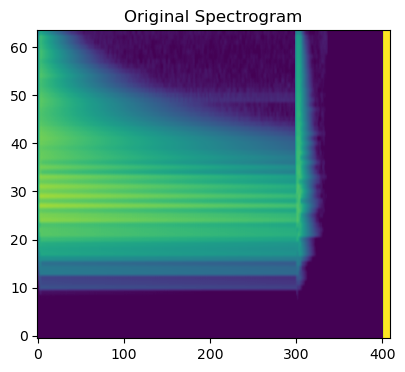

In [5]:
sample_index = 0
effect_index = 0
check_dataset(sample_index, effect_index, vocoder, standard_scalar, valid_loader)

#### Training

In [6]:

# Model Params
input_dim = train_data.shape[2]
hidden_dim = 2048
latent_dim = 256
num_effects = 3
vae = VAE(input_dim,hidden_dim, latent_dim).to(device)
# Enable mixed precision training
scaler = GradScaler()

# Training Params
num_epochs = 100
lr = 0.001

initial_beta = 0.00000001
final_beta = 0.00005
power = 3

optimizer = optim.Adam(vae.parameters(),lr=lr)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', factor=0.5, 
                             patience=5)

train_losses = []
valid_losses = []
valid_MSEs = []
valid_klds = []

for epoch in range(num_epochs):
    # Increase kl_weight gradually
    kl_weight = compute_KL_weight(epoch, num_epochs, initial_beta, final_beta, power)
    
    # Training
    vae.train()
    
    train_loss = 0
    train_MSE = 0
    train_kld = 0
    train_disentangle_loss = 0
    sparcity_loss = 0

    for i, batch_data in enumerate(train_loader):
        optimizer.zero_grad()

        batch_data_gpu_all = torch.cat([batch_data[0].select(1, i) for i in range(num_effects)], dim=0).to(device)
        recon_batch_all, mu_all, log_var_all = vae(batch_data_gpu_all)
        mu_el, mu_effect1, mu_effect2 = mu_all.split(batch_data[0].size(0))

        # Disentangle timbre and effect
        disentangle_loss = disentangle_loss_function(mu_el, mu_effect1, mu_effect2, device, batch_size)
        MSE = F.mse_loss(batch_data_gpu_all, recon_batch_all, reduction='mean')
        KLD = KLD_function(mu_all, log_var_all)
        # Compute the loss
        loss = KLD*kl_weight + MSE + disentangle_loss
        
        # total mse loss
        loss.backward()
        train_loss += loss.item()
        train_MSE += MSE.item()
        train_kld += KLD.item()
        train_disentangle_loss += disentangle_loss.item()
        optimizer.step()

    num_batches_train = len(train_loader)
    train_epoch_loss = train_loss / num_batches_train
    train_epoch_MSE = train_MSE / num_batches_train
    train_epoch_kld = train_kld / num_batches_train
    train_epoch_disentangle_loss = train_disentangle_loss / num_batches_train
    train_epoch_sparcity_loss = sparcity_loss / num_batches_train

    # Validation
    vae.eval()
    valid_loss = 0
    valid_MSE = 0
    valid_kld = 0
    valid_disentangle_loss = 0
    with torch.no_grad():
        for i, batch_data in enumerate(valid_loader):


            batch_data_gpu_all = torch.cat([batch_data[0].select(1, i) for i in range(num_effects)], dim=0).to(device)
            recon_batch_all, mu_all, log_var_all = vae(batch_data_gpu_all)
            mu_el, mu_effect1, mu_effect2 = mu_all.split(batch_data[0].size(0))

            # Disentangle timbre and effect
            disentangle_loss = disentangle_loss_function(mu_el, mu_effect1, mu_effect2, device, batch_size)
            MSE = F.mse_loss(batch_data_gpu_all, recon_batch_all, reduction='mean')
            KLD = KLD_function(mu_all, log_var_all)
            # Compute the loss
            loss = KLD*kl_weight + MSE + disentangle_loss

            valid_loss += loss.item()
            valid_MSE += MSE.item()
            valid_kld += KLD.item()
            valid_disentangle_loss += disentangle_loss.item()

            num_batches_valid = len(train_loader)
            val_epoch_loss = valid_loss / num_batches_valid
            val_epoch_MSE = valid_MSE / num_batches_valid
            val_epoch_kld = valid_kld / num_batches_valid
            val_epoch_disentangle_loss = valid_disentangle_loss / num_batches_valid

    # Print losses for this epoch
    print(f'Epoch: {epoch+1}')
    print(f'Train: Total Loss: {train_epoch_loss:.6f}, MSE: {train_epoch_MSE:.6f}, KLD: {train_epoch_kld:.6f}, Disentangle: {train_epoch_disentangle_loss:.6f}')
    print(f'Valid: Total Loss: {val_epoch_loss:.6f}, MSE: {val_epoch_MSE:.6f}, KLD: {val_epoch_kld:.6f}, Disentangle: {val_epoch_disentangle_loss:.6f}')

        
    scheduler.step(train_epoch_loss)
    train_losses.append(train_epoch_loss)
    valid_losses.append(val_epoch_loss)
    valid_MSEs.append(val_epoch_MSE)
    valid_klds.append(val_epoch_kld)

torch.save(vae.state_dict(), f'weights/best_model_{lr}_{num_epochs}_for_presentation.pth')

Epoch: 1
Train: Total Loss: 0.801713, MSE: 0.359229, KLD: 64247.687257, Disentangle: 0.441841
Valid: Total Loss: 0.077856, MSE: 0.034346, KLD: 7841.257305, Disentangle: 0.043432
Epoch: 2
Train: Total Loss: 0.508921, MSE: 0.268178, KLD: 67461.095802, Disentangle: 0.240065
Valid: Total Loss: 0.067716, MSE: 0.029725, KLD: 8039.093971, Disentangle: 0.037910
Epoch: 3
Train: Total Loss: 0.415846, MSE: 0.231252, KLD: 72565.170970, Disentangle: 0.183840
Valid: Total Loss: 0.059739, MSE: 0.025652, KLD: 9185.650424, Disentangle: 0.033991
Epoch: 4
Train: Total Loss: 0.364708, MSE: 0.205207, KLD: 76777.873808, Disentangle: 0.158629
Valid: Total Loss: 0.058205, MSE: 0.023827, KLD: 9203.012491, Disentangle: 0.034273
Epoch: 5
Train: Total Loss: 0.330575, MSE: 0.193727, KLD: 79162.432292, Disentangle: 0.135803
Valid: Total Loss: 0.053724, MSE: 0.022161, KLD: 9866.504723, Disentangle: 0.031433
Epoch: 6
Train: Total Loss: 0.306721, MSE: 0.182981, KLD: 81007.616128, Disentangle: 0.122424
Valid: Total Los

In [6]:
input_dim = train_data.shape[2]
hidden_dim = 2048
latent_dim = 256
vae = VAE(input_dim,hidden_dim, latent_dim).to(device)
vae.load_state_dict(torch.load(f'weights/best_model_0.001_100_for_presentation.pth'))

<All keys matched successfully>

### Check Losses

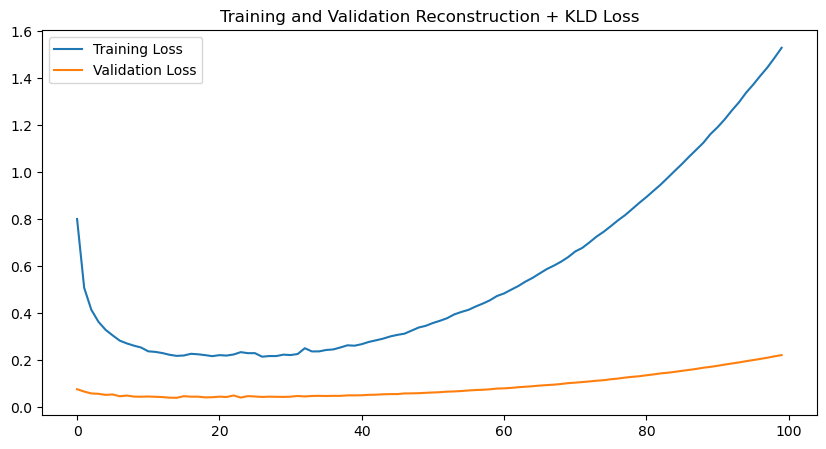

In [7]:
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Training Loss')
plt.plot(valid_losses, label='Validation Loss')
plt.title('Training and Validation Reconstruction + KLD Loss')
plt.legend()
plt.show()

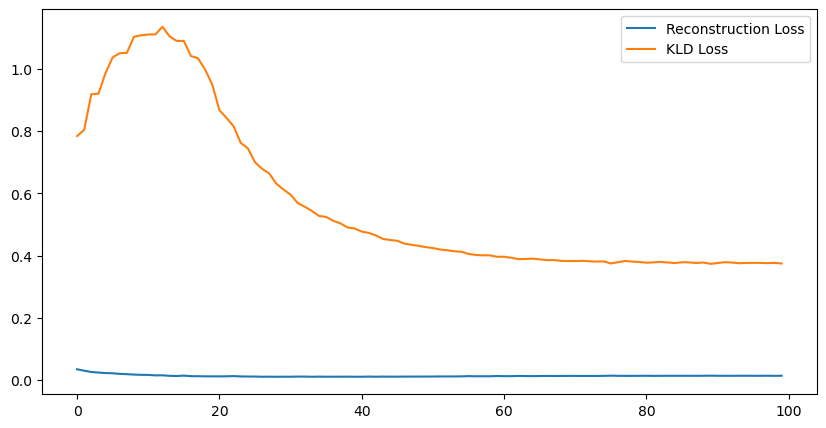

In [8]:
plt.figure(figsize=(10, 5))
plt.plot(valid_MSEs, label='Reconstruction Loss')
plt.plot(np.array(valid_klds)*0.0001, label='KLD Loss')
plt.legend()
plt.show()

### Check Reconstruction

MSE: 0.08189043402671814


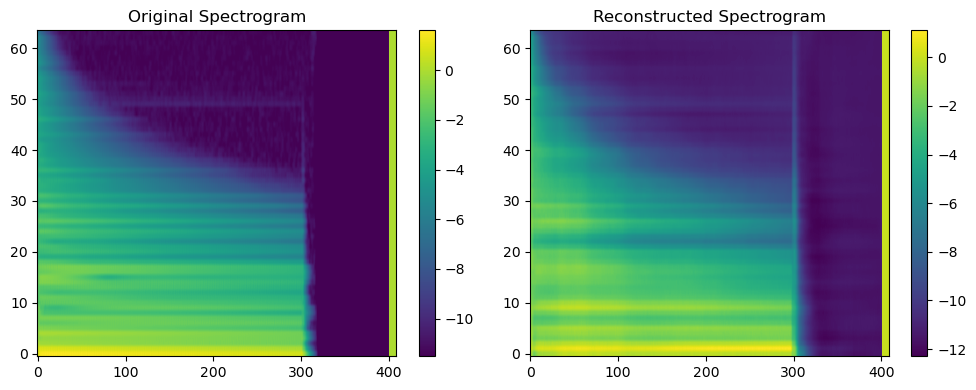

Audio before Hifi-GAN:


Audio after Hifi-GAN:


Audio after VAE and Hifi-GAN (reconstruction):


In [14]:
i = 20
audio_dir = f'datasets/nsynth-subset/nsynth-test-audios/audio'
reconstruction_vis(i, audio_dir, vocoder, device, valid_loader, standard_scalar, time_bins_num, freq_bins_num, vae)

### Plot the latent Space

In [10]:
reducer_tsne = TSNE(n_components=3)
reducer_umap = umap.UMAP(n_components=3)
latent_space_3D_vis(reducer_tsne, vae, valid_loader, device)
latent_space_3D_vis(reducer_umap, vae, valid_loader, device)

100%|██████████| 23/23 [00:00<00:00, 64.06it/s]


100%|██████████| 23/23 [00:00<00:00, 64.04it/s]


In [7]:
reducer_tsne = TSNE(n_components=2)
reducer_umap = umap.UMAP(n_components=2)
reducer_pca = PCA(n_components=2)
latent_space_2D_vis(reducer_tsne, vae, valid_loader, device)
latent_space_2D_vis(reducer_umap, vae, valid_loader, device)
latent_space_2D_vis(reducer_pca, vae, valid_loader, device)


100%|██████████| 23/23 [00:00<00:00, 55.26it/s]


100%|██████████| 23/23 [00:00<00:00, 60.54it/s]


100%|██████████| 23/23 [00:00<00:00, 61.63it/s]


### Check how disentangled the effect dimensions are

Dot Product: 0.054943814873695374


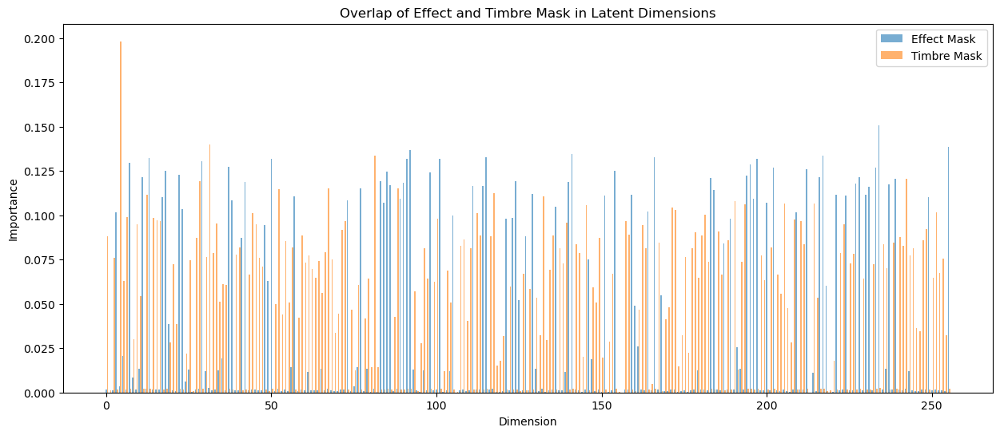

In [8]:
effect_difference_mask_norm,timbre_difference_mask_norm =  calculate_timbre_effect_masks(vae, train_loader, device, latent_dim, batch_size)
# Calculate dot product
dot_product = np.dot(effect_difference_mask_norm, timbre_difference_mask_norm)
print(f"Dot Product: {dot_product}")

# Creating a bar plot to visualize the overlap
indices = np.arange(len(effect_difference_mask_norm))
bar_width = 0.4

plt.figure(figsize=(15, 6))
plt.bar(indices, effect_difference_mask_norm, bar_width, label='Effect Mask', alpha=0.6)
plt.bar(indices + bar_width, timbre_difference_mask_norm, bar_width, label='Timbre Mask', alpha=0.6)


plt.xlabel('Dimension')
plt.ylabel('Importance')
plt.title('Overlap of Effect and Timbre Mask in Latent Dimensions')
plt.legend()
plt.show()

### Check Effect Copy

In [9]:
# Min max normalization
effect_mask = (effect_difference_mask_norm - np.min(effect_difference_mask_norm)) / (np.max(effect_difference_mask_norm) - np.min(effect_difference_mask_norm))

Threshold: 0.35
Effect dimensions selected: 75


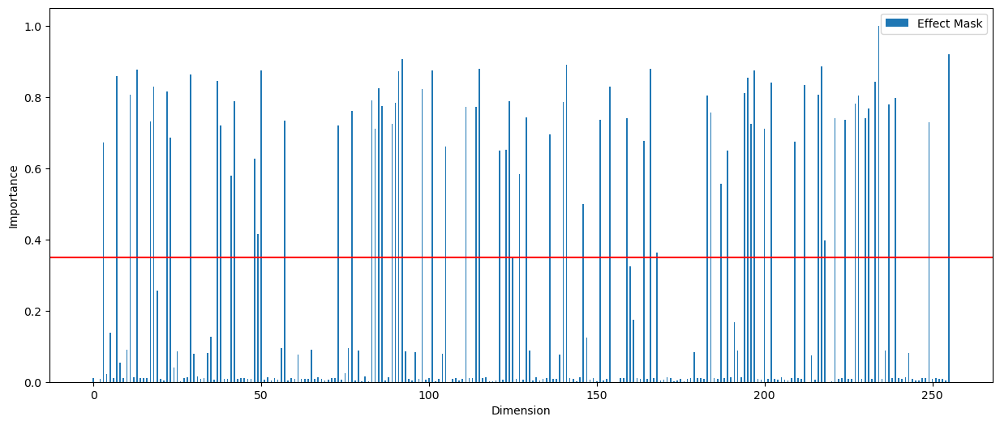

In [20]:
plt.figure(figsize=(15, 6))
plt.bar(indices, effect_mask, bar_width, label='Effect Mask', alpha=1.0)


threshold = 0.35
print(f"Threshold: {threshold}")
effect_mask_binary = np.where(effect_mask < threshold, 0, 1)
#effect_mask_binary = np.where(effect_mask < threshold, 0, effect_mask)
print(f'Effect dimensions selected: {effect_mask_binary.sum()}')  
plt.axhline(y=threshold, color='r', linestyle='-')

plt.xlabel('Dimension')
plt.ylabel('Importance')
plt.legend()
plt.show()

## Copy effects Test

In [21]:
effect_params = np.load('datasets/effects/eq_params-test.npy')
effect_params.shape

(1482, 2)

In [22]:
audio_dir = f'datasets/nsynth-subset/nsynth-test-audios/audio'
audio_files = os.listdir(audio_dir)
print(len(audio_files))
fn_STFT = TacotronSTFT(
    filter_length=1024,
    hop_length=160,
    win_length=1024,
    n_mel_channels=64,
    sampling_rate=16000,
    mel_fmin=0,
    mel_fmax=8000,
)
duration = 4
target_length=int(duration * 102.4)

1482


Effect Type: lowpass
Result-Target: 
 Cos: 0.02, Eucl: 1.51
Result-Approx: 
 Cos: 0.02, Eucl: 1.32


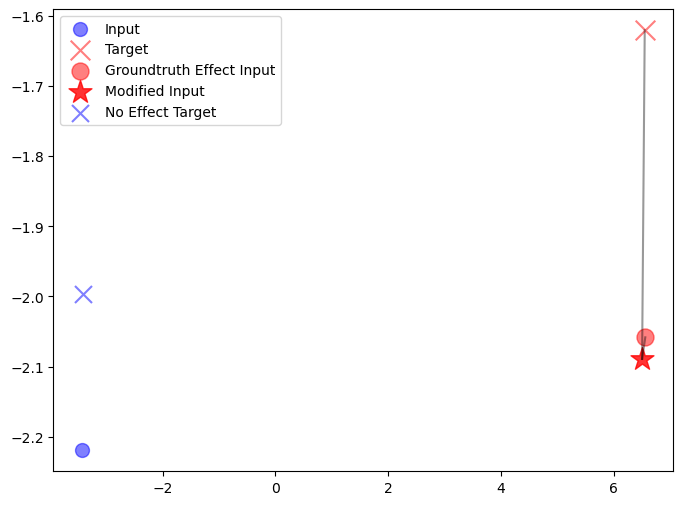

MSE between Result and Groundtruth: 0.312721


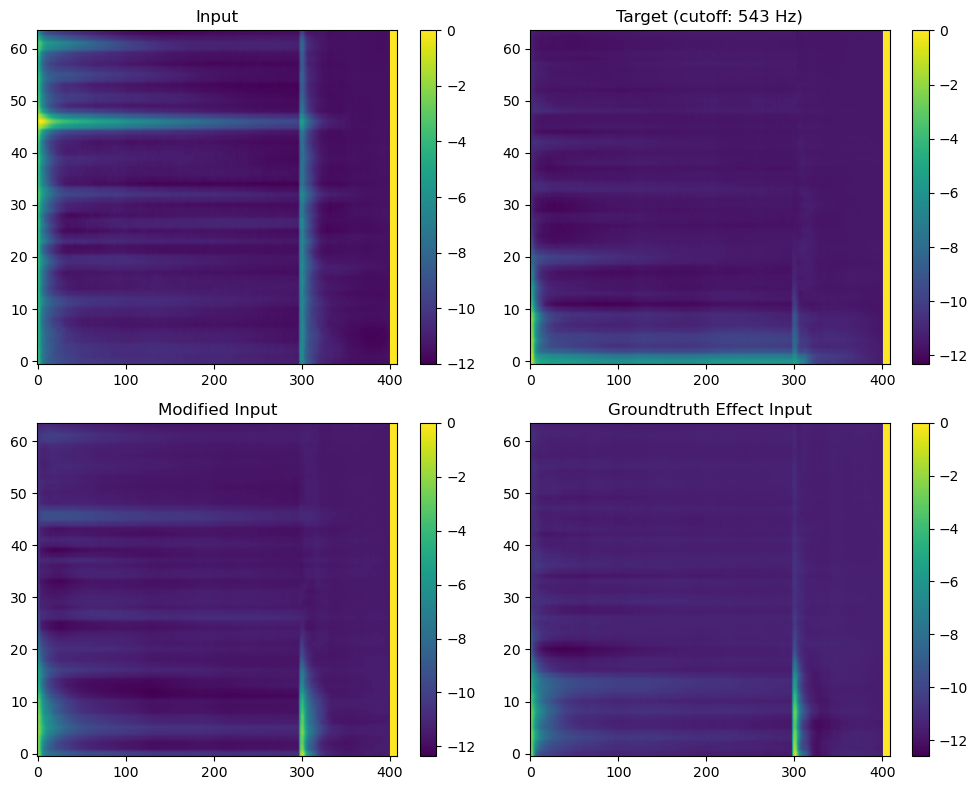

Input:


Target


No Effect Target


Modified Input (Result)


Groundtruth Effect Input


Effect Type: lowpass
Result-Target: 
 Cos: 0.46, Eucl: 7.90
Result-Approx: 
 Cos: 0.02, Eucl: 1.51


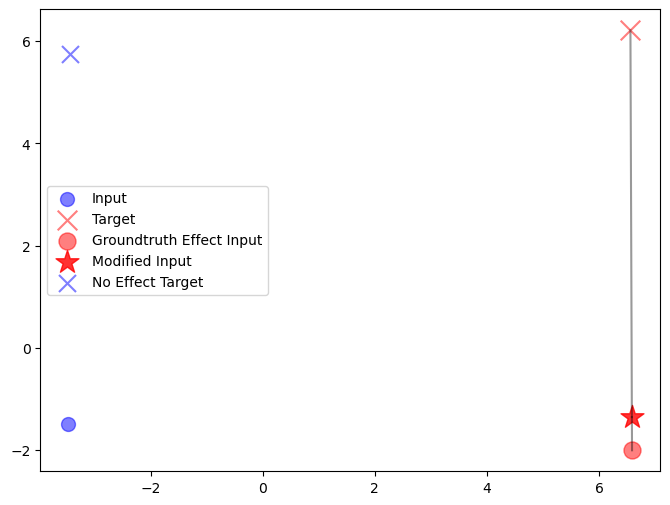

MSE between Result and Groundtruth: 1.472420


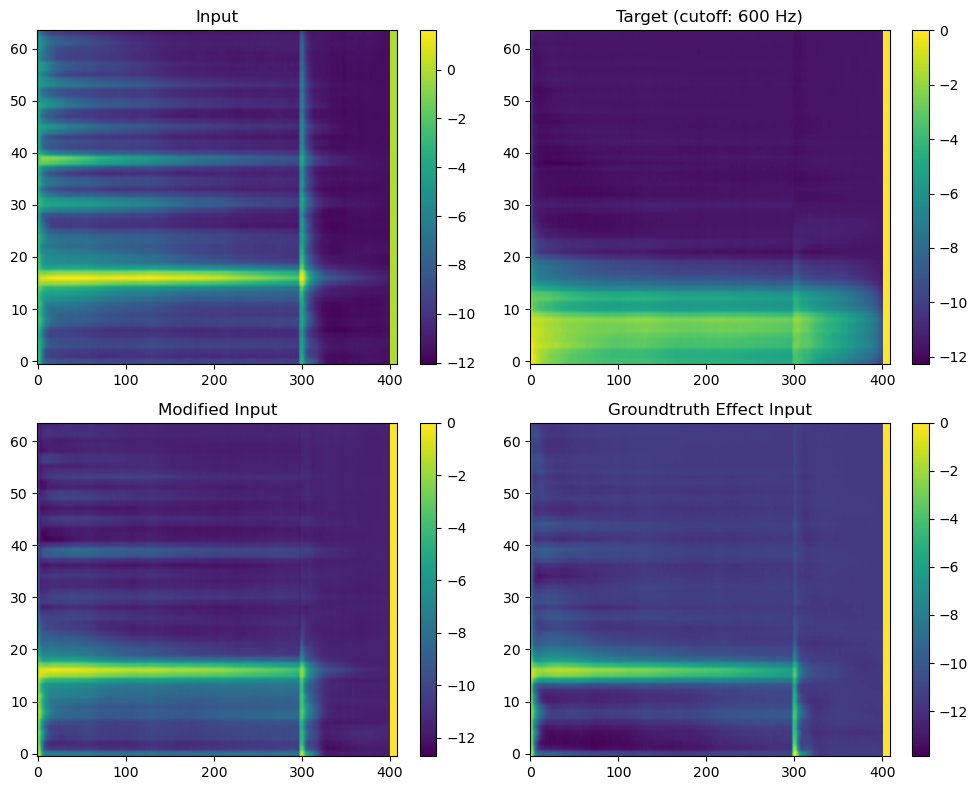

Input:


Target


No Effect Target


Modified Input (Result)


Groundtruth Effect Input


Effect Type: lowpass
Result-Target: 
 Cos: 0.66, Eucl: 9.74
Result-Approx: 
 Cos: 0.02, Eucl: 1.31


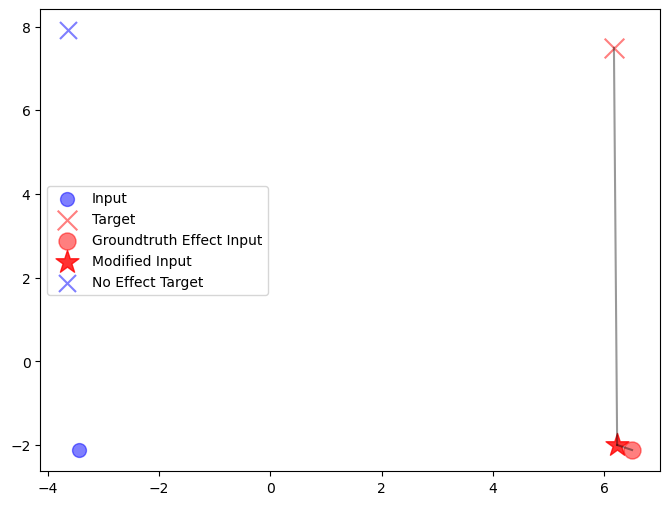

MSE between Result and Groundtruth: 0.804408


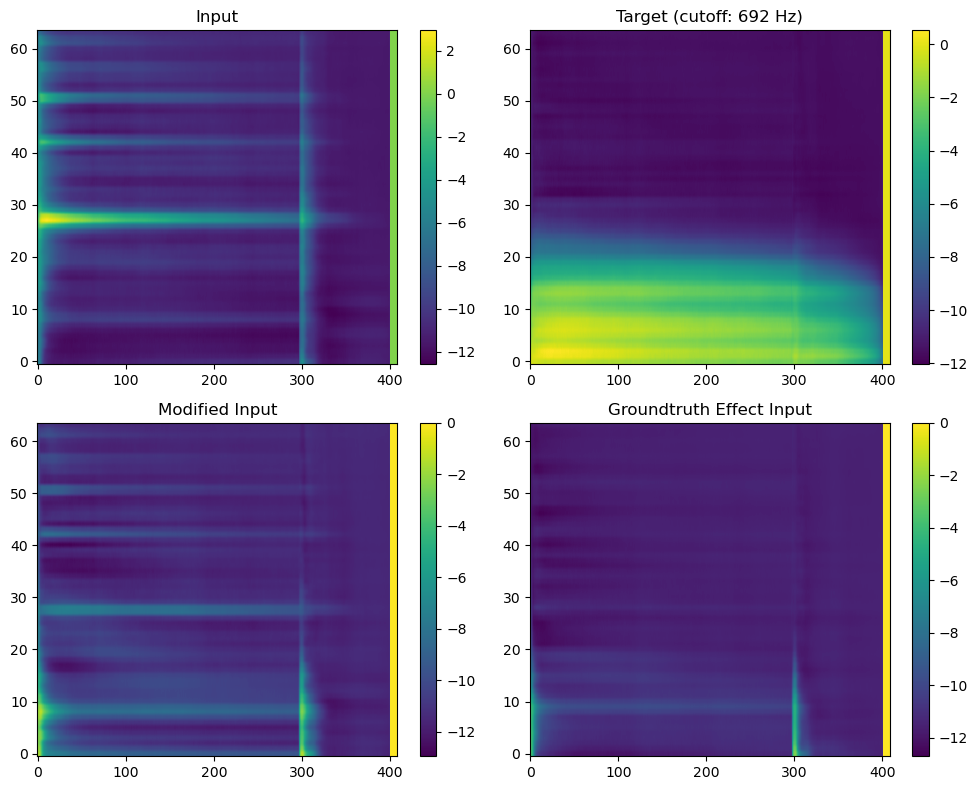

Input:


Target


No Effect Target


Modified Input (Result)


Groundtruth Effect Input


Effect Type: lowpass
Result-Target: 
 Cos: 0.53, Eucl: 7.69
Result-Approx: 
 Cos: 0.02, Eucl: 1.71


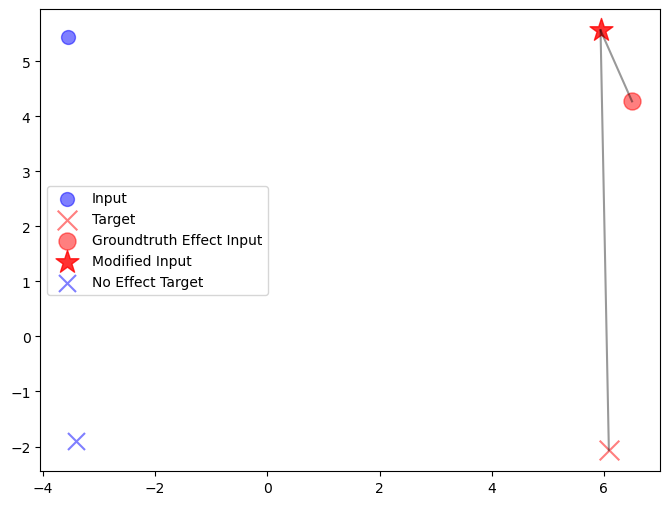

MSE between Result and Groundtruth: 1.623259


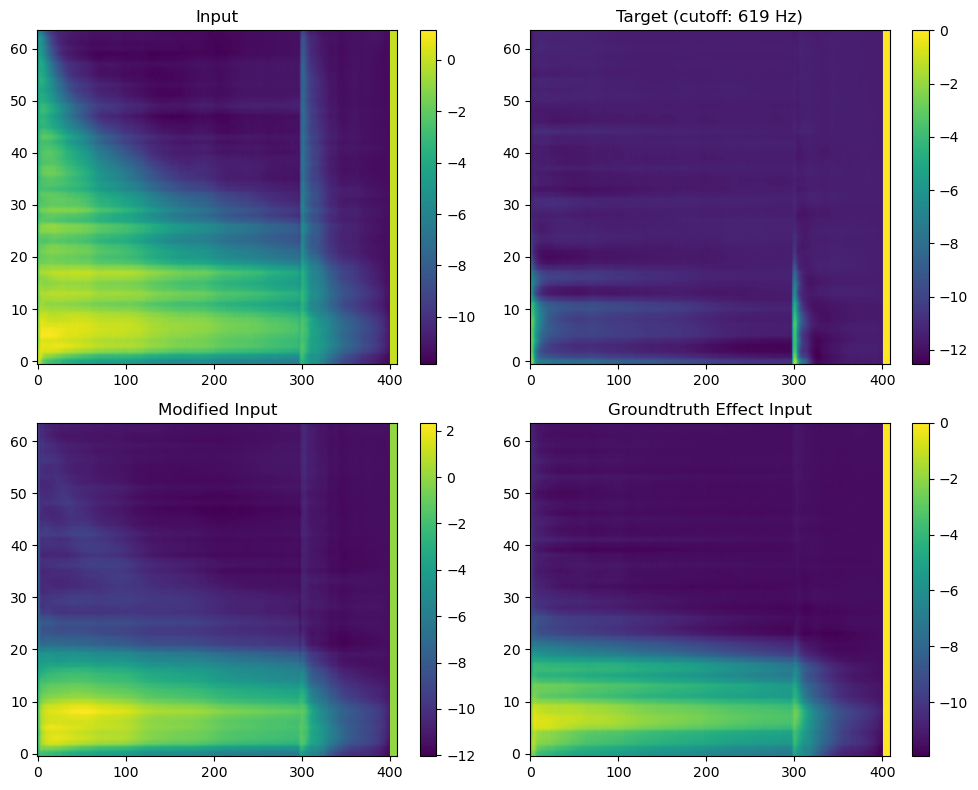

Input:


Target


No Effect Target


Modified Input (Result)


Groundtruth Effect Input


Effect Type: lowpass
Result-Target: 
 Cos: 0.15, Eucl: 3.84
Result-Approx: 
 Cos: 0.01, Eucl: 1.18


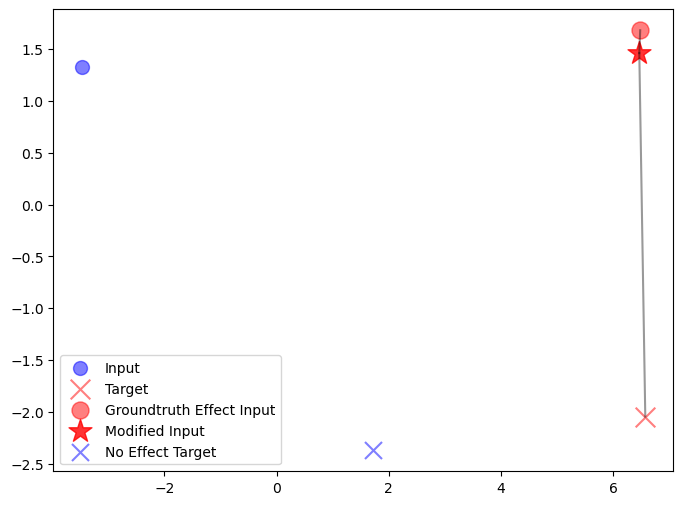

MSE between Result and Groundtruth: 3.888544


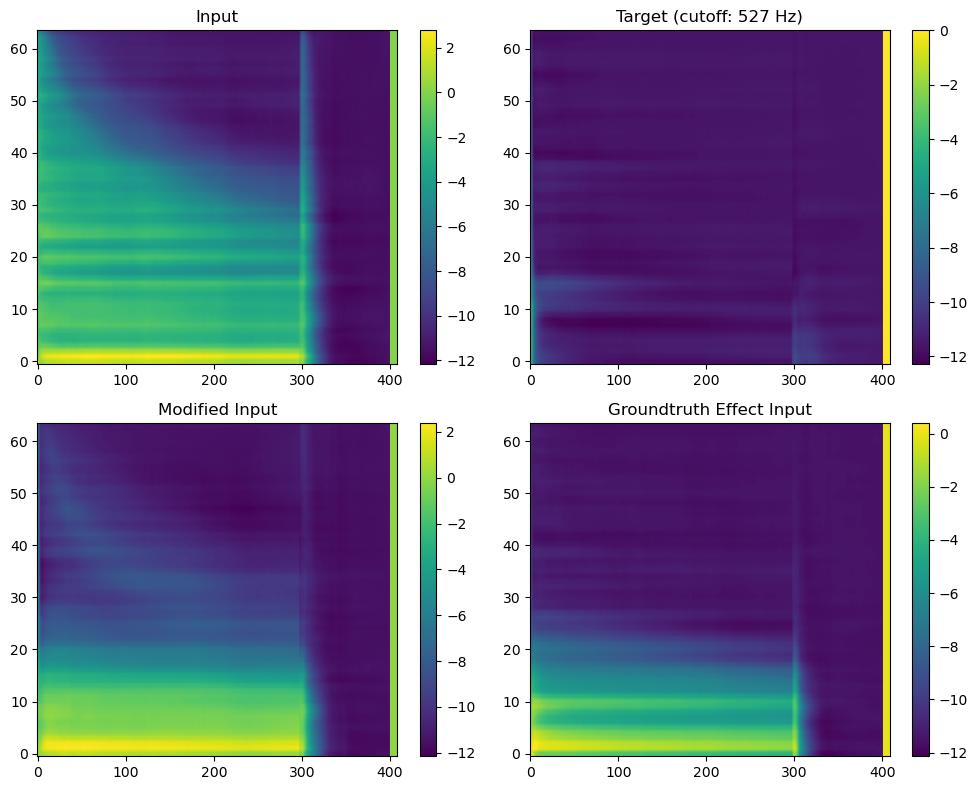

Input:


Target


No Effect Target


Modified Input (Result)


Groundtruth Effect Input


Effect Type: lowpass
Result-Target: 
 Cos: 0.23, Eucl: 6.63
Result-Approx: 
 Cos: 0.02, Eucl: 1.93


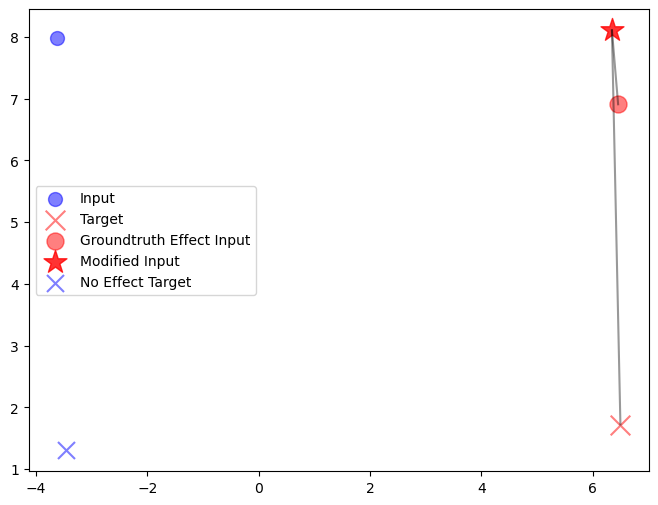

MSE between Result and Groundtruth: 6.074843


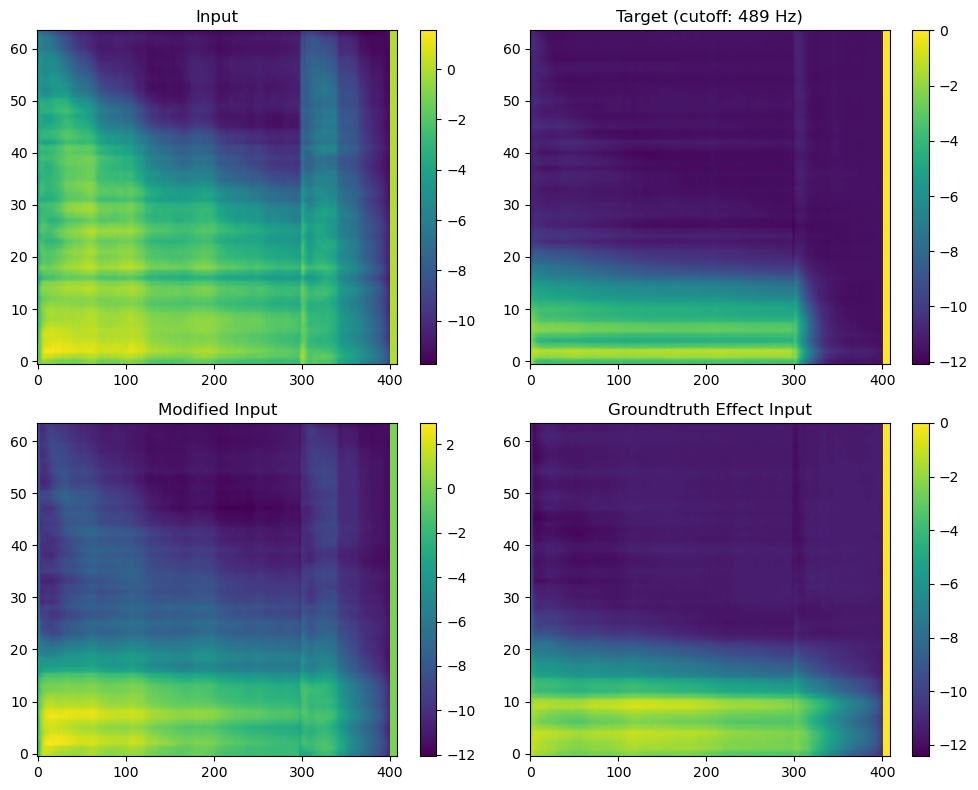

Input:


Target


No Effect Target


Modified Input (Result)


Groundtruth Effect Input


Effect Type: lowpass
Result-Target: 
 Cos: 0.61, Eucl: 9.72
Result-Approx: 
 Cos: 0.01, Eucl: 0.93


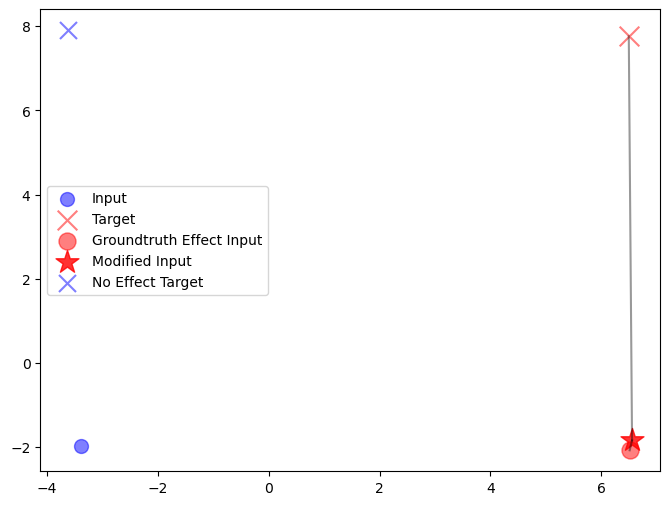

MSE between Result and Groundtruth: 0.585980


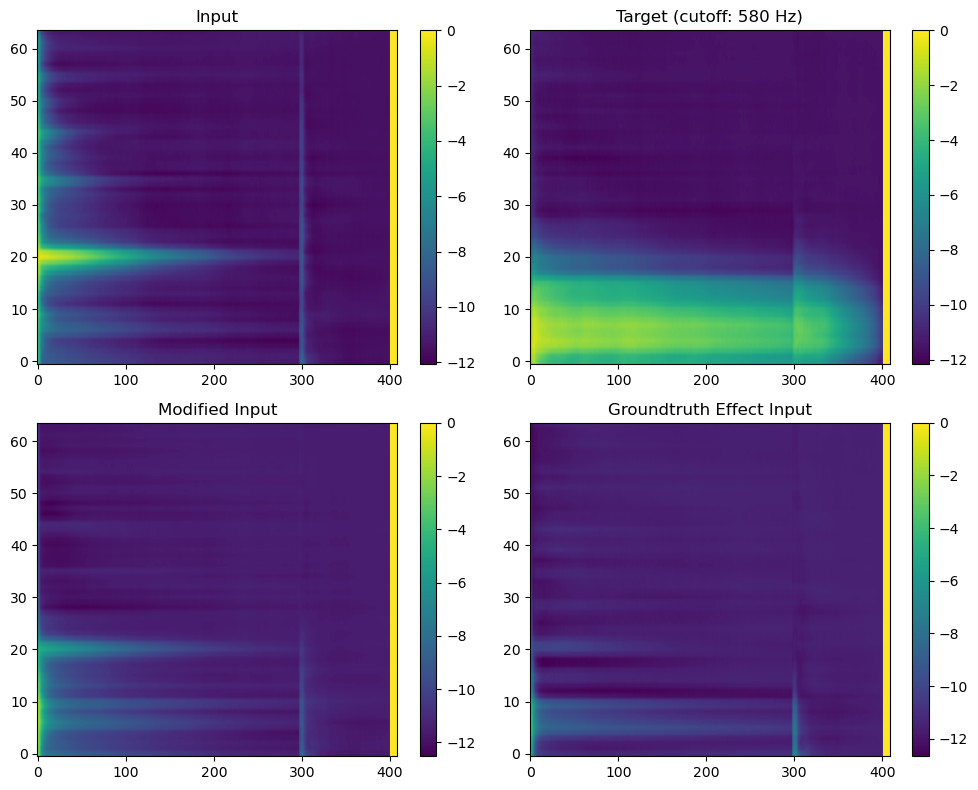

Input:


Target


No Effect Target


Modified Input (Result)


Groundtruth Effect Input


Effect Type: highpass
Result-Target: 
 Cos: 0.12, Eucl: 1.83
Result-Approx: 
 Cos: 0.02, Eucl: 0.80


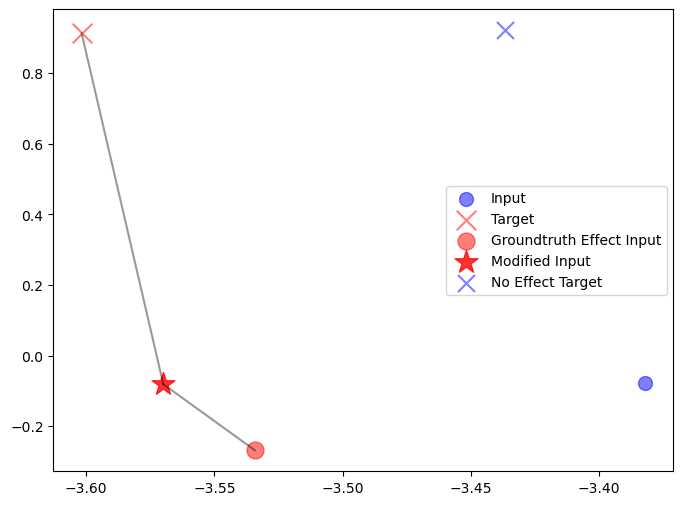

MSE between Result and Groundtruth: 6.358164


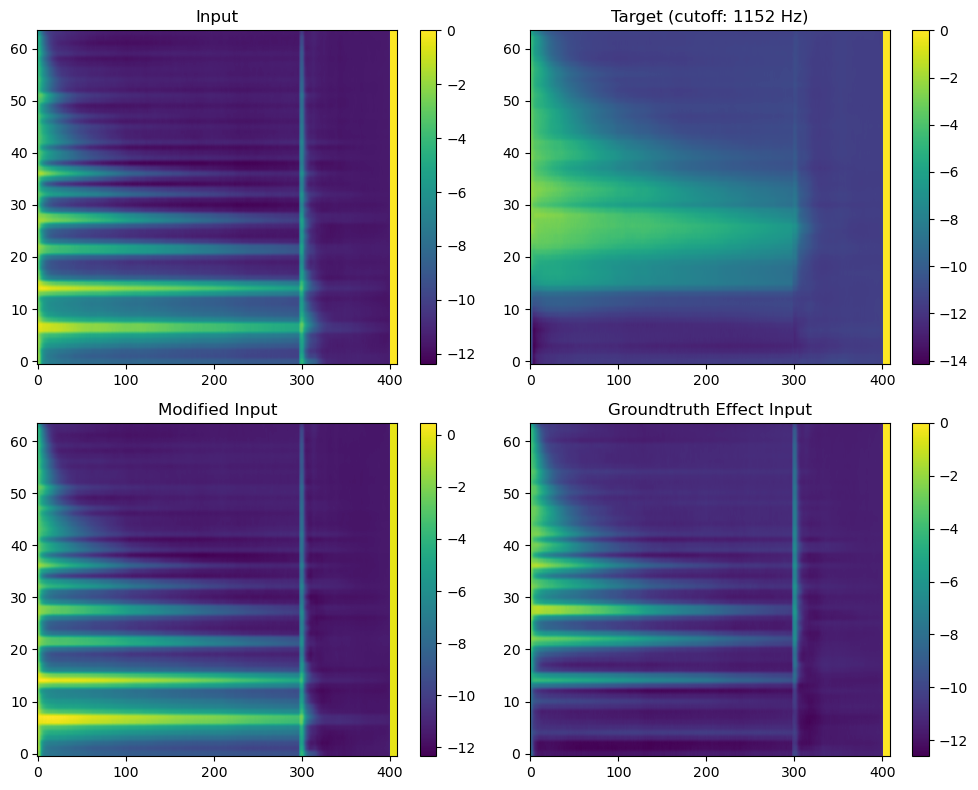

Input:


Target


No Effect Target


Modified Input (Result)


Groundtruth Effect Input


Effect Type: highpass
Result-Target: 
 Cos: 0.16, Eucl: 2.34
Result-Approx: 
 Cos: 0.03, Eucl: 0.90


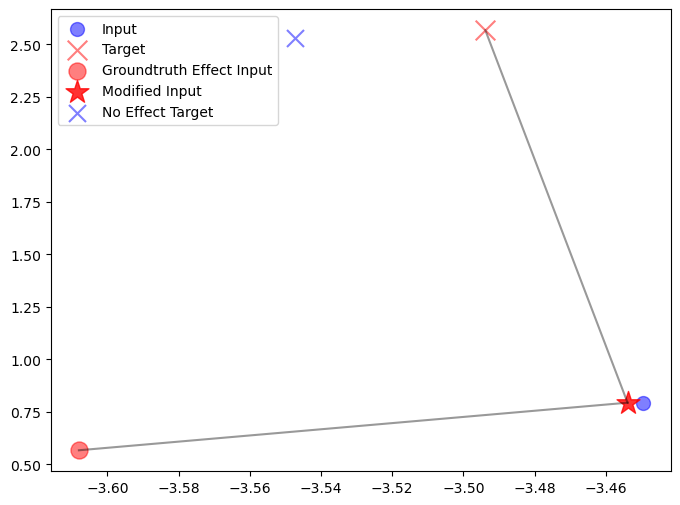

MSE between Result and Groundtruth: 17.809202


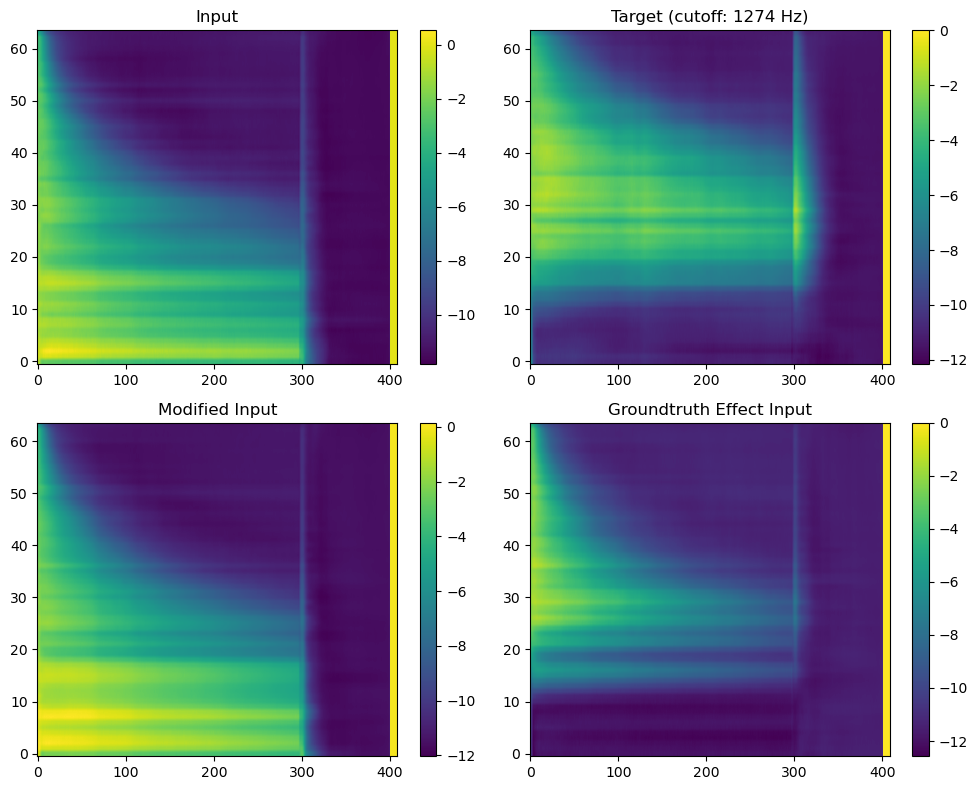

Input:


Target


No Effect Target


Modified Input (Result)


Groundtruth Effect Input


Effect Type: lowpass
Result-Target: 
 Cos: 0.14, Eucl: 3.67
Result-Approx: 
 Cos: 0.01, Eucl: 1.02


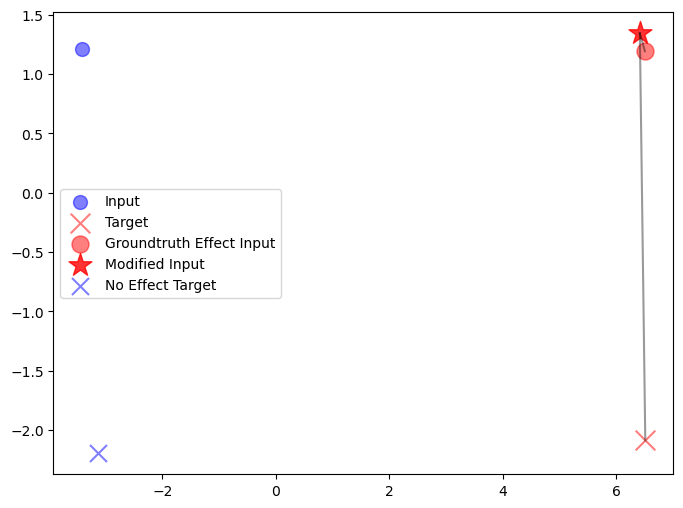

MSE between Result and Groundtruth: 1.400919


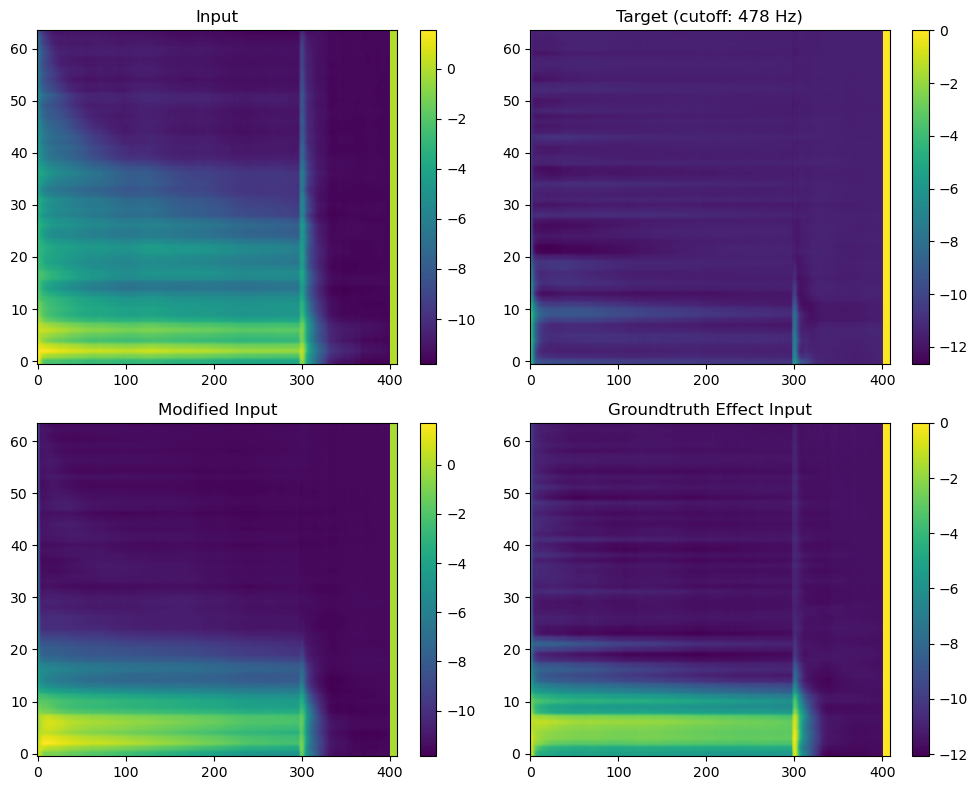

Input:


Target


No Effect Target


Modified Input (Result)


Groundtruth Effect Input


In [23]:
np.random.seed(2)

num_iterations = 10

for _ in range(num_iterations):
    input_index = np.random.randint(len(valid_dataset))
    target_index = input_index
    while target_index == input_index:  # Ensure target_index is not the same as input_index
        target_index = np.random.randint(len(valid_dataset))

    effect_type = random.choice(['lowpass', 'highpass'])
    print(f"Effect Type: {effect_type}")
    effect_indx = 2 if effect_type == 'lowpass' else 1

    target_cutoff = effect_params[target_index][effect_indx-1]


    input_spec = valid_dataset[input_index][0][0]
    
    assert input_index < len(audio_files), f"input_index must be less than {len(audio_files)}"
    sr = 16000
    input_audio, _= librosa.load(os.path.join(audio_dir, audio_files[input_index]), sr=sr)
    effect_function =  low_pass_filter if effect_type == 'lowpass' else high_pass_filter
    input_groundtruth_audio = effect_function(input_audio, target_cutoff, sr, order=5)
    input_groundtruth_spec = get_hifi_mel(input_groundtruth_audio, target_length, fn_STFT).reshape(1,-1)
    input_groundtruth_spec = torch.tensor(standard_scalar.transform(input_groundtruth_spec), dtype=torch.float32)[0]

    target_spec = valid_dataset[target_index][0][effect_indx]
    clean_target = valid_dataset[target_index][0][0]
    copy_effects_vis(input_spec, target_spec, input_groundtruth_spec, clean_target, target_cutoff, effect_mask_binary, vae, device, standard_scalar, vocoder, time_bins_num, freq_bins_num, reducer_pca)

In [ ]:
2)fix reconsatruction, fix hifi 
1) expand effecta: chorus, reverb, distortiion, pitch shifting, see whether the model is good enough
3) remove super high or super low notes, combine notes togehter into melody